In [2]:
import os
import pandas as pd
from sklearn import preprocessing
import torch
from torch.utils.data import Dataset, DataLoader
from torchvision.transforms import functional as F
import torchvision.transforms as T
from PIL import Image
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import torch.optim as optim
from tqdm import tqdm
import cv2
import matplotlib.pyplot as plt
import numpy as np
from torchvision import transforms as torchtrans
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import albumentations as A
from albumentations.pytorch.transforms import ToTensorV2

In [3]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [4]:
def load_dataset(dir):
    images = []
    bboxes = []
    labels = []
    image_paths = []

    for filename in os.listdir(dir):
        if filename.endswith(".jpg"):
            image_path = os.path.join(dir, filename)
            image_paths.append(image_path)

            img = cv2.imread(image_path)
            images.append(img)

            bbox_file = os.path.join(dir, filename.split('.')[0] + '.bboxes.tsv')
            label_file = os.path.join(dir, filename.split('.')[0] + '.bboxes.labels.tsv')

            # Read bounding boxes
            with open(bbox_file, 'r') as bf:
                bbox_list = []
                for line in bf:
                    bbox = list(map(int, line.strip().split()))
                    bbox_list.append(bbox)
                bboxes.append(bbox_list)

            # Read labels
            with open(label_file, 'r') as lf:
                label_list = []
                for line in lf:
                    label = line.strip()
                    label_list.append(label)
                labels.append(label_list)

    return images, image_paths, bboxes, labels


In [5]:
# Load training data
train_images, train_image_paths, train_bboxes, train_labels = load_dataset(
    '/content/gdrive/MyDrive/Q4/drones_dataset/train'
)

# Load validation data
val_images, val_image_paths, val_bboxes, val_labels = load_dataset(
    '/content/gdrive/MyDrive/Q4/drones_dataset/train'
)

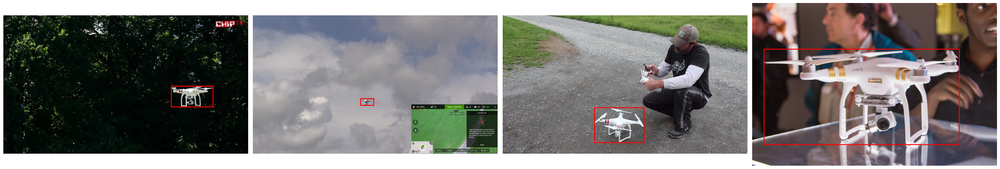

In [6]:
plt.figure(figsize=(30, 30))

for i in range(4):
    plt.subplot(1, 4, i + 1)
    image_copy = train_images[i].copy()

    for bbox in train_bboxes[i]:
        cv2.rectangle(image_copy, (bbox[0], bbox[1]), (bbox[2], bbox[3]), (0, 0, 255), 5)

    plt.imshow(cv2.cvtColor(image_copy, cv2.COLOR_BGR2RGB))
    plt.axis('off')

plt.tight_layout()
plt.show()


In [7]:
df_train = pd.DataFrame({
    'boxes': train_bboxes,
    'labels': train_labels,
    'images': train_image_paths
})

df_train.head()

,boxes,labels,images
0,"[[1317, 559, 1644, 722]]",[drone],/content/gdrive/MyDrive/Q4/drones_dataset/trai...
1,"[[845, 657, 948, 710]]",[drone],/content/gdrive/MyDrive/Q4/drones_dataset/trai...
2,"[[720, 728, 1108, 1002]]",[drone],/content/gdrive/MyDrive/Q4/drones_dataset/trai...
3,"[[92, 363, 1624, 1114]]",[drone],/content/gdrive/MyDrive/Q4/drones_dataset/trai...
4,"[[732, 405, 818, 457]]",[drone],/content/gdrive/MyDrive/Q4/drones_dataset/trai...


In [8]:
df_train['labels'] = df_train['labels'].apply(lambda x: [1 if label == 'drone' else label for label in x])
expanded_df_train = pd.DataFrame(columns=['xmin', 'ymin', 'xmax', 'ymax', 'label', 'image_path'])
for idx, row in df_train.iterrows():
    for bbox in row['boxes']:
        xmin, ymin, xmax, ymax = bbox
        new_row = pd.DataFrame({
            'xmin': [xmin],
            'ymin': [ymin],
            'xmax': [xmax],
            'ymax': [ymax],
            'label': [row['labels'][0]],
            'image_path': [row['images']]
        })
        expanded_df_train = pd.concat([expanded_df_train, new_row], ignore_index=True)
        expanded_df_train['xmin'] = expanded_df_train['xmin'].astype(np.float32)
        expanded_df_train['ymin'] = expanded_df_train['ymin'].astype(np.float32)
        expanded_df_train['xmax'] = expanded_df_train['xmax'].astype(np.float32)
        expanded_df_train['ymax'] = expanded_df_train['ymax'].astype(np.float32)
        expanded_df_train['label'] = expanded_df_train['label'].astype(np.int32)

expanded_df_train.head()


,xmin,ymin,xmax,ymax,label,image_path
0,1317.0,559.0,1644.0,722.0,1,/content/gdrive/MyDrive/Q4/drones_dataset/trai...
1,845.0,657.0,948.0,710.0,1,/content/gdrive/MyDrive/Q4/drones_dataset/trai...
2,720.0,728.0,1108.0,1002.0,1,/content/gdrive/MyDrive/Q4/drones_dataset/trai...
3,92.0,363.0,1624.0,1114.0,1,/content/gdrive/MyDrive/Q4/drones_dataset/trai...
4,732.0,405.0,818.0,457.0,1,/content/gdrive/MyDrive/Q4/drones_dataset/trai...


In [9]:
df_val = pd.DataFrame({
    'boxes': val_bboxes,
    'labels': val_labels,
    'images': val_image_paths
})

df_val.head()

,boxes,labels,images
0,"[[1317, 559, 1644, 722]]",[drone],/content/gdrive/MyDrive/Q4/drones_dataset/trai...
1,"[[845, 657, 948, 710]]",[drone],/content/gdrive/MyDrive/Q4/drones_dataset/trai...
2,"[[720, 728, 1108, 1002]]",[drone],/content/gdrive/MyDrive/Q4/drones_dataset/trai...
3,"[[92, 363, 1624, 1114]]",[drone],/content/gdrive/MyDrive/Q4/drones_dataset/trai...
4,"[[732, 405, 818, 457]]",[drone],/content/gdrive/MyDrive/Q4/drones_dataset/trai...


In [10]:
df_val['labels'] = df_val['labels'].apply(lambda x: [1 if label == 'drone' else label for label in x])
expanded_df_val = pd.DataFrame(columns=['xmin', 'ymin', 'xmax', 'ymax', 'label', 'image_path'])
for idx, row in df_val.iterrows():
    for bbox in row['boxes']:
        xmin, ymin, xmax, ymax = bbox
        new_row = pd.DataFrame({
            'xmin': [xmin],
            'ymin': [ymin],
            'xmax': [xmax],
            'ymax': [ymax],
            'label': [row['labels'][0]],
            'image_path': [row['images']]
        })
        expanded_df_val = pd.concat([expanded_df_val, new_row], ignore_index=True)
        expanded_df_val['xmin'] = expanded_df_val['xmin'].astype(np.float32)
        expanded_df_val['ymin'] = expanded_df_val['ymin'].astype(np.float32)
        expanded_df_val['xmax'] = expanded_df_val['xmax'].astype(np.float32)
        expanded_df_val['ymax'] = expanded_df_val['ymax'].astype(np.float32)
        expanded_df_val['label'] = expanded_df_val['label'].astype(np.int32)

expanded_df_val.head()


,xmin,ymin,xmax,ymax,label,image_path
0,1317.0,559.0,1644.0,722.0,1,/content/gdrive/MyDrive/Q4/drones_dataset/trai...
1,845.0,657.0,948.0,710.0,1,/content/gdrive/MyDrive/Q4/drones_dataset/trai...
2,720.0,728.0,1108.0,1002.0,1,/content/gdrive/MyDrive/Q4/drones_dataset/trai...
3,92.0,363.0,1624.0,1114.0,1,/content/gdrive/MyDrive/Q4/drones_dataset/trai...
4,732.0,405.0,818.0,457.0,1,/content/gdrive/MyDrive/Q4/drones_dataset/trai...


In [11]:
class CustomDataset(Dataset):
    def __init__(self, dataframe, transforms=None):
        self.dataframe = dataframe
        self.transforms = transforms
        self.image_paths = dataframe['image_path'].unique()

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
#         img = Image.open(img_path).convert("RGB")
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).astype(np.float32)
        img= img/255.0
        records = self.dataframe[self.dataframe['image_path'] == img_path]

        boxes = records[['xmin', 'ymin', 'xmax', 'ymax']].values
        labels = records['label'].values

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)

        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        # suppose all instances are not crowd
        iscrowd = torch.zeros((len(labels),), dtype=torch.int64)

        # img = tv_tensors.Image(img)

        target = {}
        target['boxes'] = boxes
        target['labels'] = labels
        target['image_id'] = idx
        target["area"] = area
        target["iscrowd"] = iscrowd
        target["boxes"]=boxes
        # target["boxes"] = tv_tensors.BoundingBoxes(boxes, format="XYXY", canvas_size=F.get_size(img))

        if self.transforms:

            sample = self.transforms(image = img,
                                     bboxes = target['boxes'],
                                     labels = labels)

            img = sample['image']
            target['boxes'] = torch.Tensor(sample['bboxes'])

        return img, target

def get_transform(train):
    if train:
        return A.Compose([
                            A.RandomBrightnessContrast(p=0.5),
                            ToTensorV2(p=1.0)
                            ], bbox_params={'format': 'pascal_voc', 'label_fields': ['labels']})
    else:
        return A.Compose([
                        ToTensorV2(p=1.0)
                        ], bbox_params={'format': 'pascal_voc', 'label_fields': ['labels']})

train_dataset = CustomDataset(expanded_df_train, transforms=get_transform(True))
train_dataloader = DataLoader(train_dataset, batch_size=4, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))

val_dataset = CustomDataset(expanded_df_val, transforms=get_transform(False))
val_dataloader = DataLoader(val_dataset, batch_size=4, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))


In [12]:
# Load the model pre-trained on COCO
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True, pretrained_backbone=True)

in_features = model.roi_heads.box_predictor.cls_score.in_features

num_classes = len(expanded_df_train['label'].unique()) + 1
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained_backbone' is deprecated since 0.13 and may be removed in the future, please use 'weights_backbone' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weigh

In [13]:
# Training parameters
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(
    params,
    lr=0.005,
    momentum=0.9,
    weight_decay=0.0005
)

lr_scheduler = torch.optim.lr_scheduler.StepLR(
    optimizer,
    step_size=3,
    gamma=0.5
)
num_epochs = 20

In [14]:
device

device(type='cuda')

In [15]:
!git clone https://github.com/pytorch/vision.git
# !git checkout v0.3.0

!cp vision/references/detection/utils.py ./
!cp vision/references/detection/transforms.py ./
!cp vision/references/detection/coco_eval.py ./
!cp vision/references/detection/engine.py ./
!cp vision/references/detection/coco_utils.py ./

Cloning into 'vision'...
remote: Enumerating objects: 509106, done.
remote: Counting objects: 100% (22716/22716), done.
remote: Compressing objects: 100% (1136/1136), done.
remote: Total 509106 (delta 21590), reused 22632 (delta 21542), pack-reused 486390
Receiving objects: 100% (509106/509106), 986.47 MiB | 32.36 MiB/s, done.
Resolving deltas: 100% (474825/474825), done.


In [16]:
!pip3 install pycocotools

In [17]:
from engine import train_one_epoch, evaluate

In [18]:

for epoch in range(num_epochs):
    train_one_epoch(model, optimizer, train_dataloader, device, epoch, print_freq=20)
    lr_scheduler.step()

    evaluate(model, val_dataloader, device=device)


Epoch: [0]  [ 0/87]  eta: 0:07:09  lr: 0.000063  loss: 0.8045 (0.8045)  loss_classifier: 0.6531 (0.6531)  loss_box_reg: 0.1377 (0.1377)  loss_objectness: 0.0052 (0.0052)  loss_rpn_box_reg: 0.0085 (0.0085)  time: 4.9332  data: 0.2027  max mem: 4935
Epoch: [0]  [20/87]  eta: 0:02:05  lr: 0.001225  loss: 0.3296 (0.4358)  loss_classifier: 0.1701 (0.2842)  loss_box_reg: 0.1319 (0.1387)  loss_objectness: 0.0056 (0.0076)  loss_rpn_box_reg: 0.0034 (0.0053)  time: 1.7149  data: 0.5506  max mem: 5188
Epoch: [0]  [40/87]  eta: 0:01:16  lr: 0.002386  loss: 0.2242 (0.3399)  loss_classifier: 0.0723 (0.1899)  loss_box_reg: 0.1370 (0.1372)  loss_objectness: 0.0038 (0.0085)  loss_rpn_box_reg: 0.0021 (0.0042)  time: 1.3921  data: 0.2472  max mem: 5190
Epoch: [0]  [60/87]  eta: 0:00:45  lr: 0.003548  loss: 0.1476 (0.2775)  loss_classifier: 0.0397 (0.1406)  loss_box_reg: 0.0943 (0.1233)  loss_objectness: 0.0064 (0.0086)  loss_rpn_box_reg: 0.0037 (0.0050)  time: 1.7836  data: 0.5668  max mem: 6783
Epoch: [

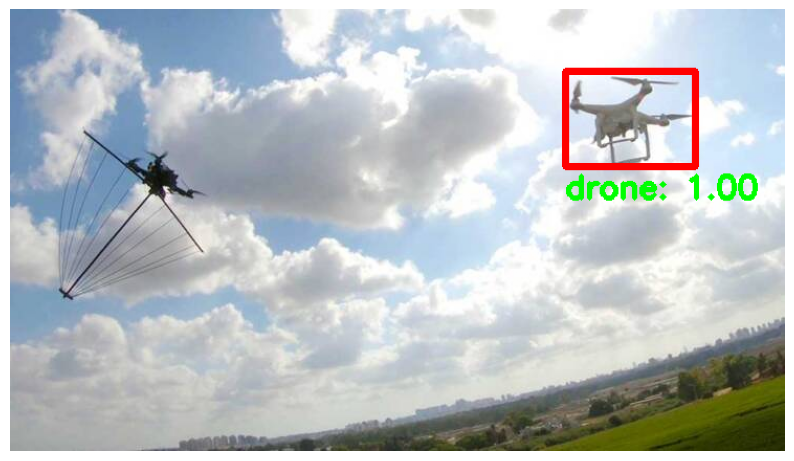

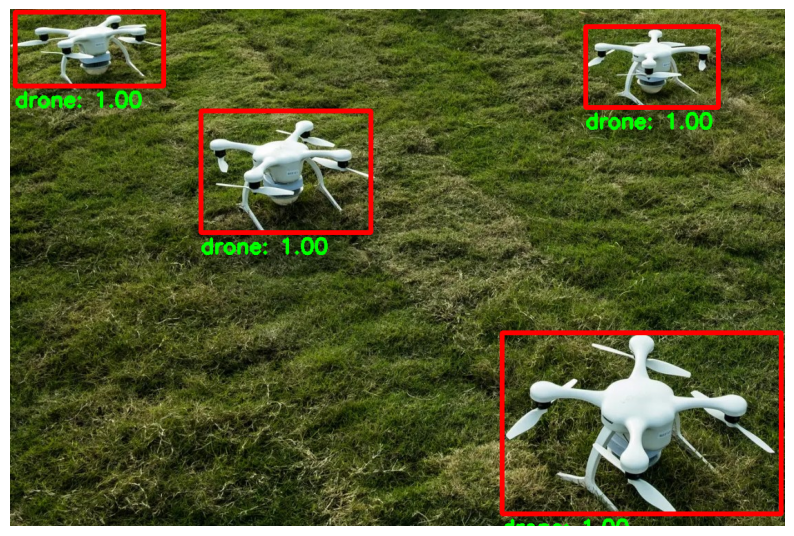

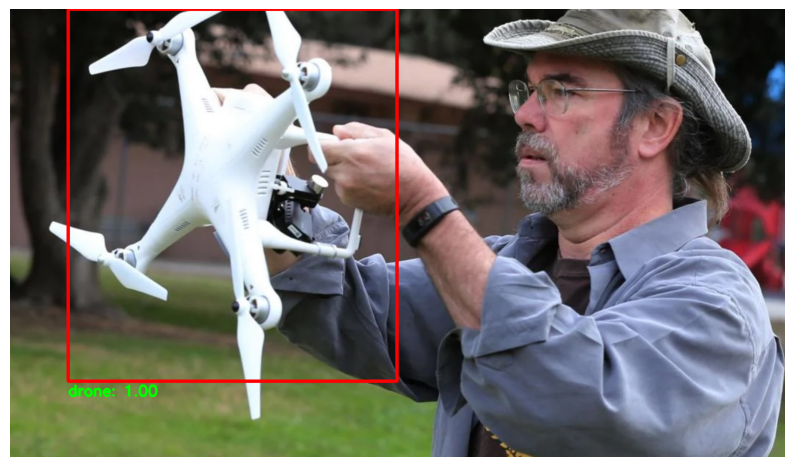

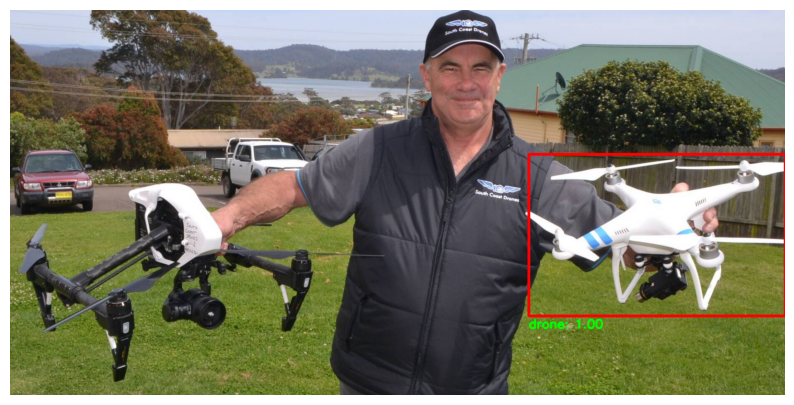

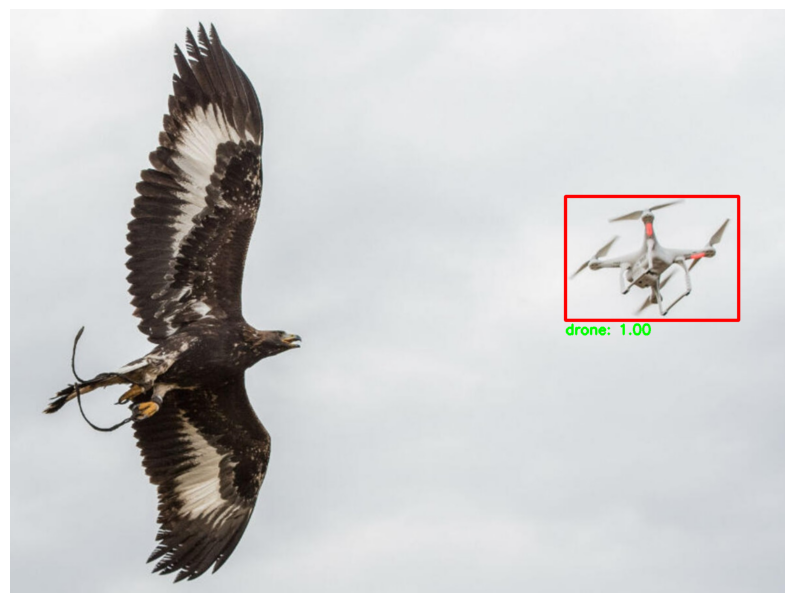

...

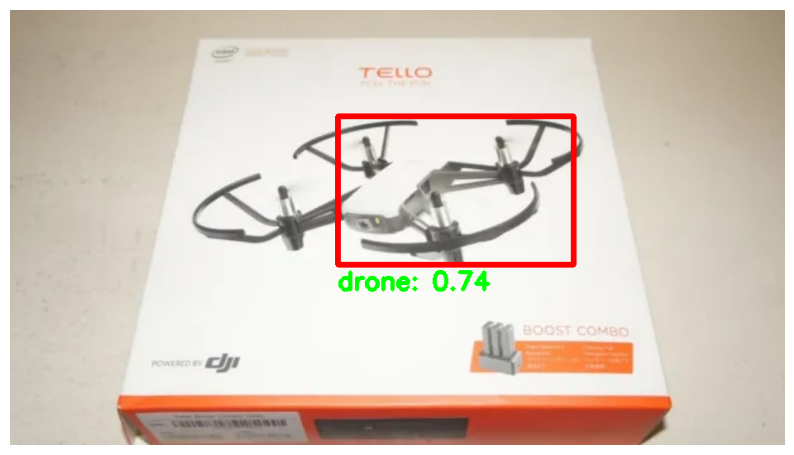

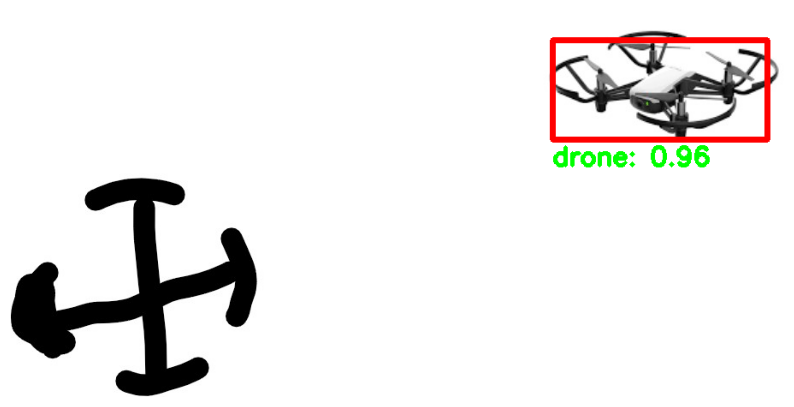

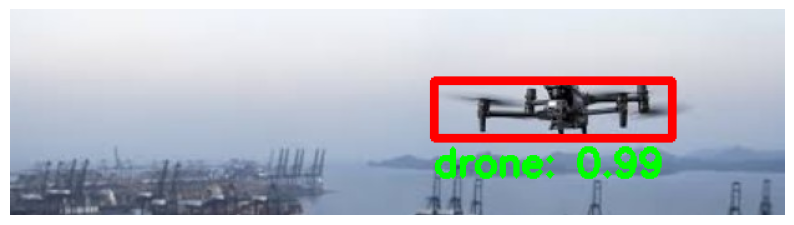

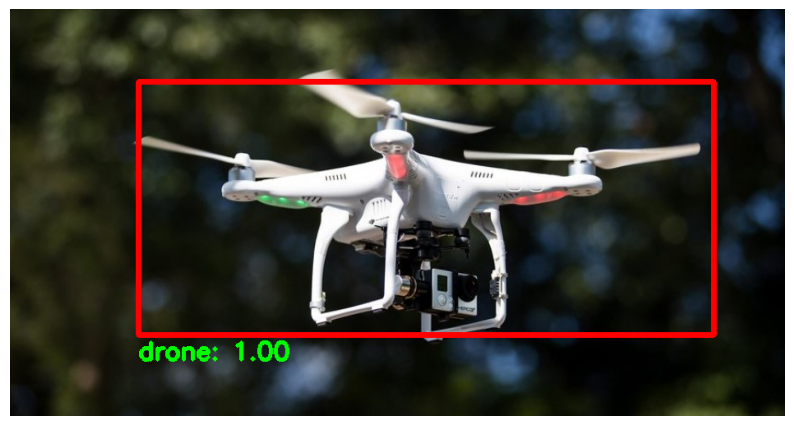

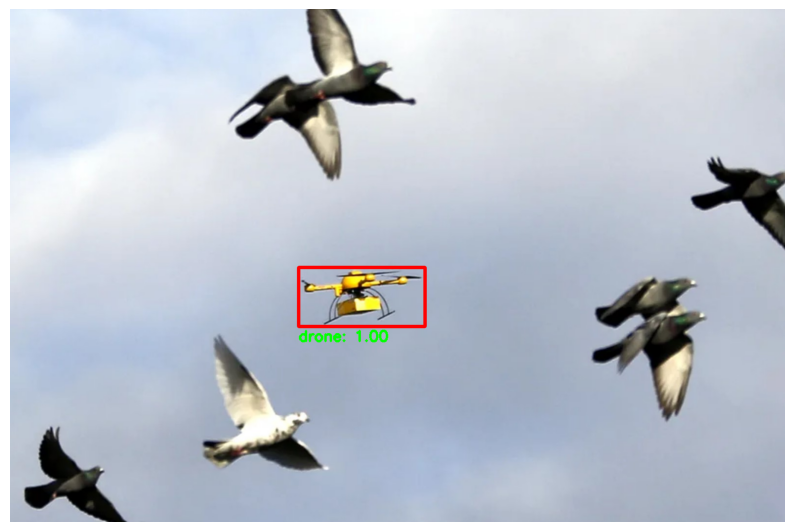

In [33]:
test_images_dir = '/content/gdrive/MyDrive/Q4/test'

transform = T.Compose([
    T.ToTensor()

])


model.eval()
def plot_image_with_boxes(image, predictions):
    img_np = np.array(image)
    for box, label, score in zip(predictions['boxes'], predictions['labels'], predictions['scores']):
        if score >= 0.73:
            xmin, ymin, xmax, ymax = box.int().tolist()
            cv2.rectangle(img_np, (xmin, ymin), (xmax, ymax), (255, 0, 0), 6)
            cv2.putText(img_np, f'drone: {score:.2f}', (xmin, ymax + 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 4)
    plt.figure(figsize=(10, 10))
    plt.imshow(img_np)
    plt.axis('off')
    plt.show()
for img_file in os.listdir(test_images_dir):
    img_path = os.path.join(test_images_dir, img_file)
#     image = Image.open(img_path).convert("RGB")
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).astype(np.float32)
    img= img/255.0
    x = transform(img)
    x = x.to(device)
    with torch.no_grad():
        predictions = model([x])[0]
    plot_image_with_boxes(img, predictions)

